In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import matplotlib.pyplot as plt

Frame 1/5187: frame_0.jpg


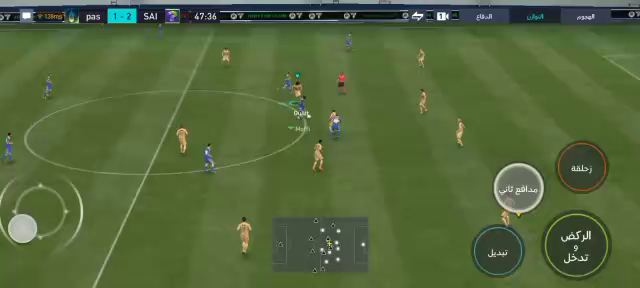

Frame 2/5187: frame_1.jpg


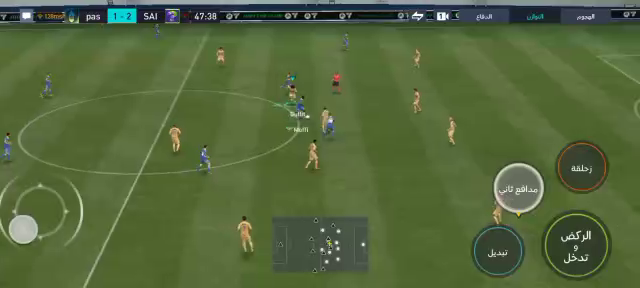

Frame 3/5187: frame_2.jpg


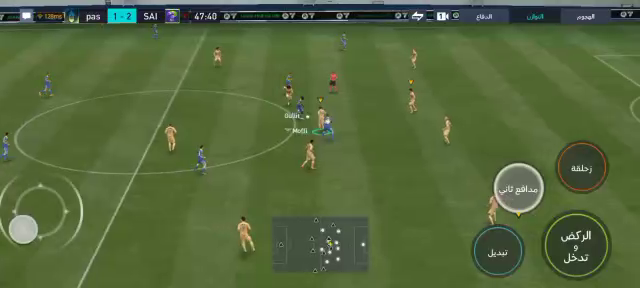

Frame 4/5187: frame_3.jpg


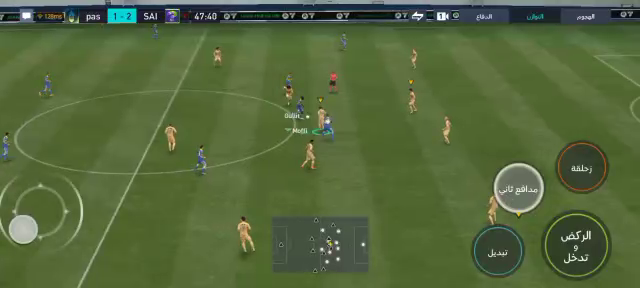

Frame 5/5187: frame_4.jpg


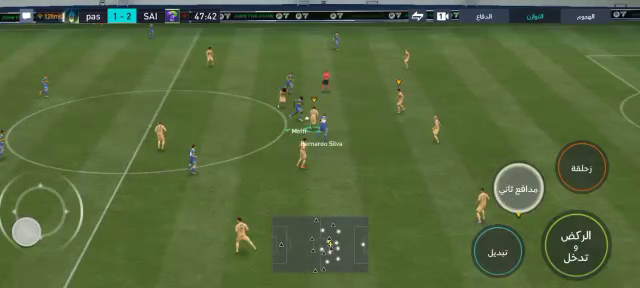

Frame 6/5187: frame_5.jpg


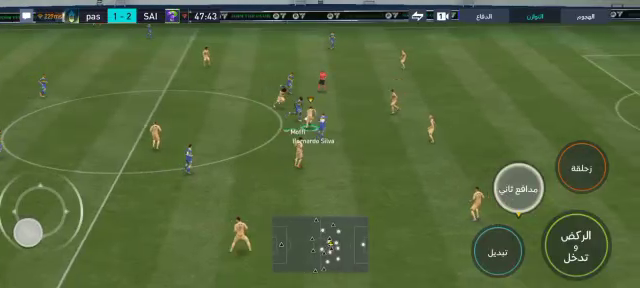

Frame 7/5187: frame_6.jpg


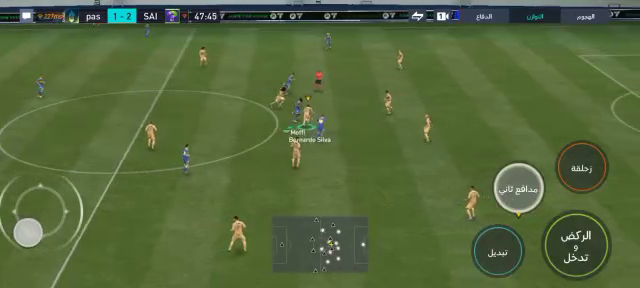

Frame 8/5187: frame_7.jpg


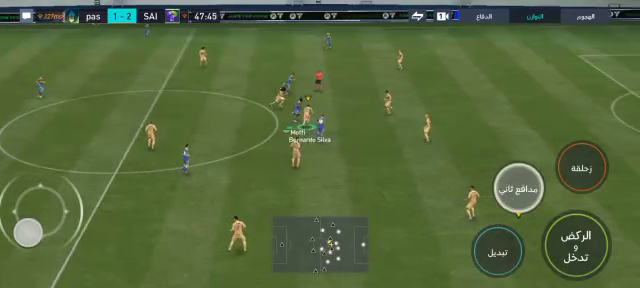

Frame 9/5187: frame_8.jpg


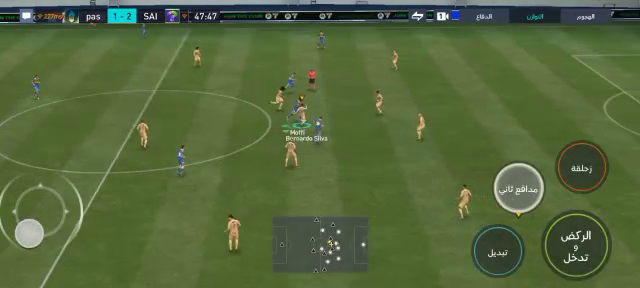

Frame 10/5187: frame_9.jpg


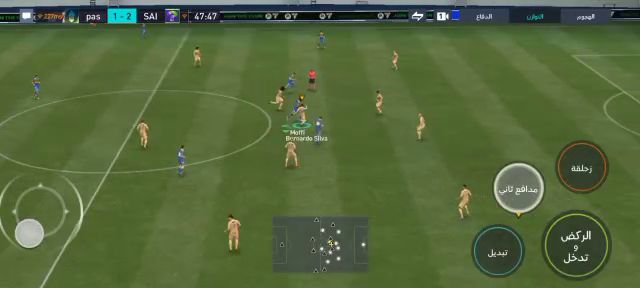

Frame 11/5187: frame_10.jpg


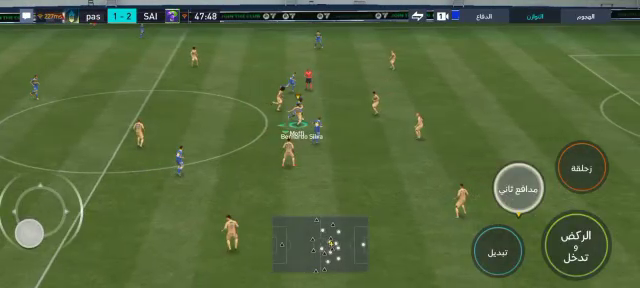

Frame 12/5187: frame_11.jpg


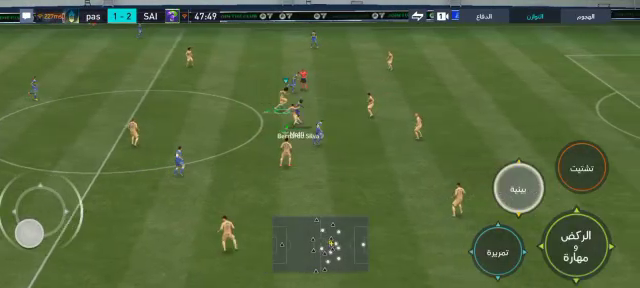

Frame 13/5187: frame_12.jpg


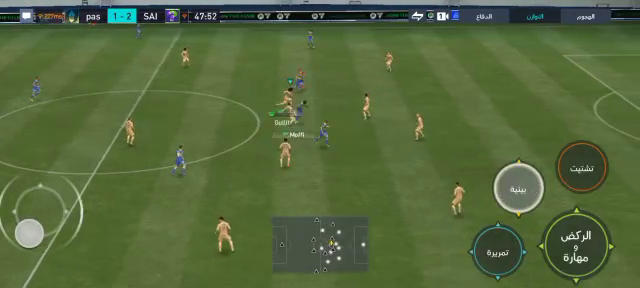

Frame 14/5187: frame_13.jpg


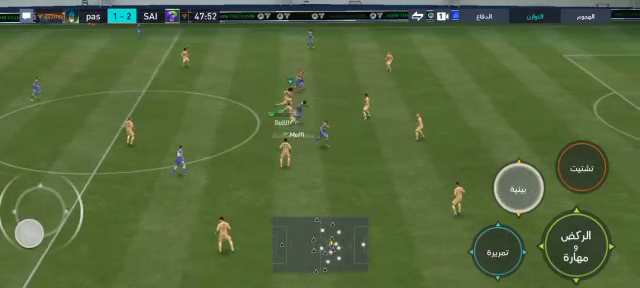

Frame 15/5187: frame_14.jpg


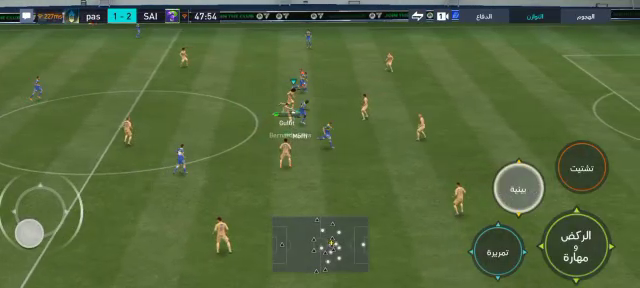

Frame 16/5187: frame_15.jpg


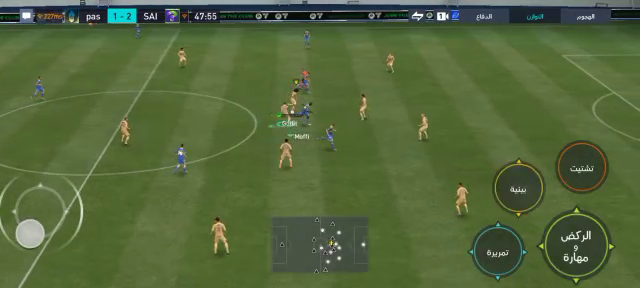

Frame 17/5187: frame_16.jpg


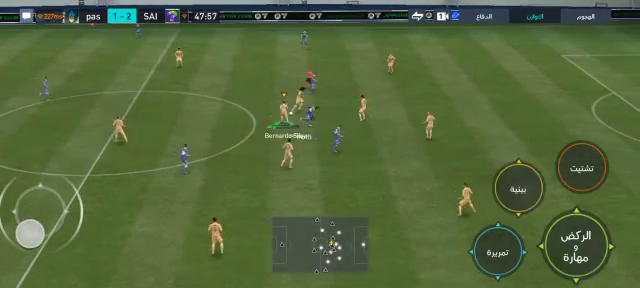

Frame 18/5187: frame_17.jpg


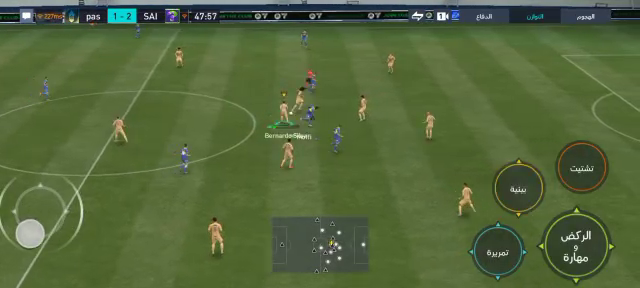

In [ ]:
# step 1 and 2
start_frame = 0
end_frame = 95
cap = cv2.VideoCapture('DataExample.mp4')
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

if end_frame > total_frames:
    end_frame = total_frames

frame_count = 0

while cap.isOpened() and frame_count < total_frames:
    ret, frame = cap.read()
    if not ret:
        break
    if start_frame <= frame_count <= end_frame:
        frame_file = f'frame_{frame_count}.jpg'
        cv2.imwrite(frame_file, frame)
        print(f"Frame {frame_count + 1}/{total_frames}: {frame_file}")
        cv2_imshow(frame)

    frame_count += 1
    if frame_count > end_frame:
        break

cap.release()

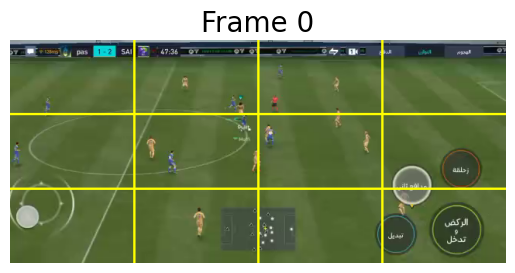

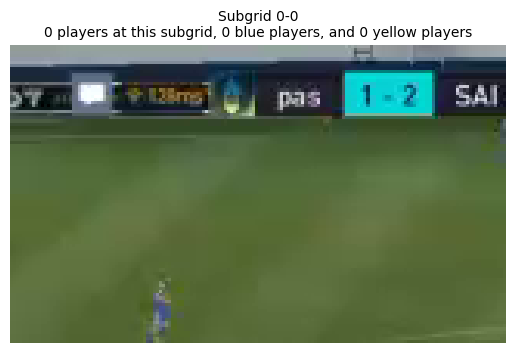

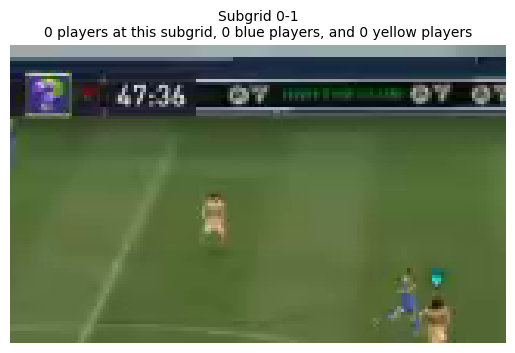

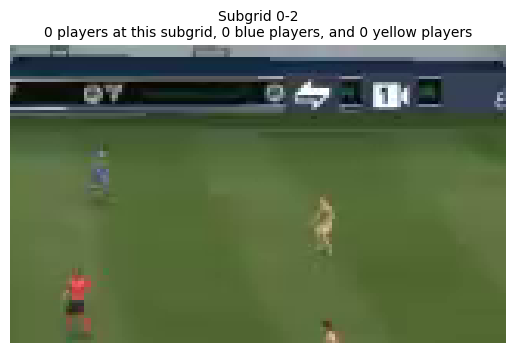

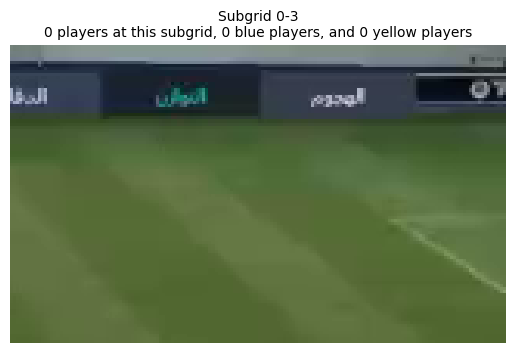

...

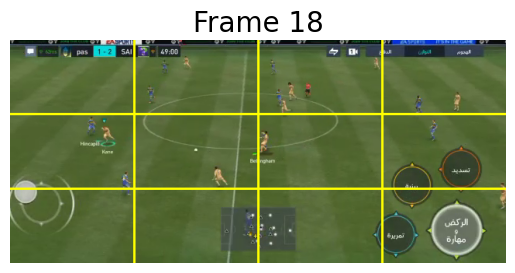

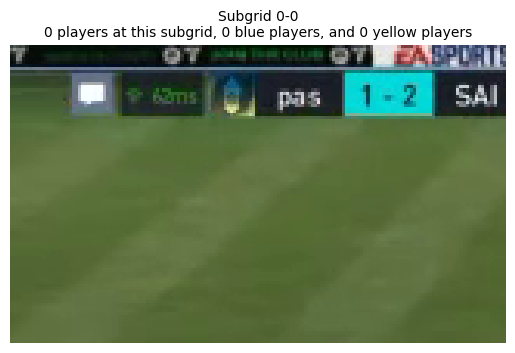

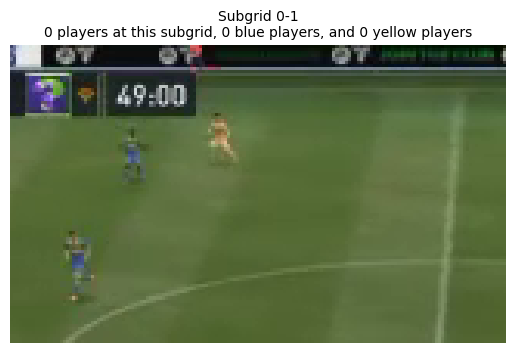

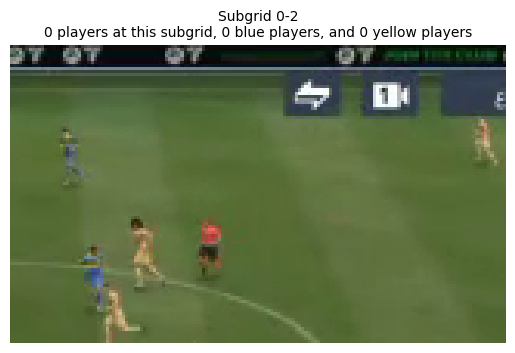

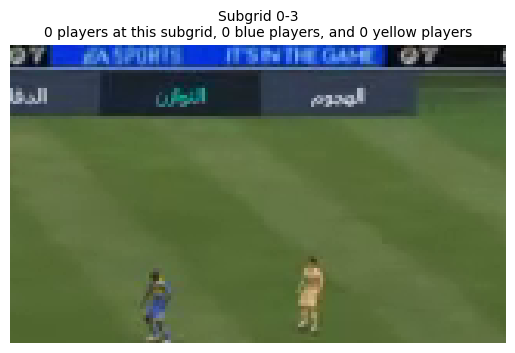

In [ ]:
#step6

frame_ranges = [(0, 5), (20, 25), (50, 55), (70, 75), (90, 95)]
cap = cv2.VideoCapture('DataExample.mp4')
counter = 0
frametotal = []

for start_frame, end_frame in frame_ranges:
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    cap.set(cv2.CAP_PROP_POS_FRAMES, start_frame)
    for frame_count in range(start_frame, end_frame + 1):
        ret, frame = cap.read()
        frametotal.append(frame)
        counter += 1
        frame_count += 1
        if frame_count > end_frame:
            break
cap.release()


threshold_distance = 19
def calculate_player_count(pixels):
    count = 0
    visited_indices = []

    for i in range(len(pixels)):
        if i not in visited_indices:
            count += 1
            visited_indices.append(i)

            for j in range(i + 1, len(pixels)):
                if abs(pixels[j][0] - pixels[i][0]) <= threshold_distance \
                        and abs(pixels[j][1] - pixels[i][1]) <= threshold_distance:
                    visited_indices.append(j)
    return count


# Display frames and sub-grids with labels
for i in range(len(frametotal)):

    width = frametotal[i].shape[1]
    height = frametotal[i].shape[0]
    grid_size = (3, 4)

    sub_grid_height = height // grid_size[0]
    sub_grid_width = width // grid_size[1]

    num_x_lines = 3
    num_y_lines = 2

    x_step = int(width / (num_x_lines + 1))
    y_step = int(height / (num_y_lines + 1))


    frame_with_lines = frametotal[i].copy()


    for j in range(num_x_lines):
        x = (j + 1) * x_step
        cv2.line(frame_with_lines, (x, 0), (x, height), (0, 255, 255), 2)

    for j in range(num_y_lines):
        y = (j + 1) * y_step
        cv2.line(frame_with_lines, (0, y), (width, y), (0, 255, 255), 2)

    plt.imshow(cv2.cvtColor(frame_with_lines, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title("Frame " + str(i), fontsize=20)
    plt.show()


    hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    blue_pixels = []
    yellow_pixels =[]

    yellow_range = (np.array([183, 146, 108]),
                    np.array([255, 255, 255]))

    blue_range = (np.array([64, 80, 119]),
                  np.array([162, 170, 180]))

    for row in range(grid_size[0]):
        for col in range(grid_size[1]):
            start_y = row * sub_grid_height
            end_y = start_y + sub_grid_height
            start_x = col * sub_grid_width
            end_x = start_x + sub_grid_width


            pixel_color = hsv_frame[row, col]

            if blue_range[0][0] <= pixel_color[0] <= blue_range[1][0] and blue_range[0][1] <= pixel_color[1] <= blue_range[1][1] and blue_range[0][2] <= pixel_color[2] <= blue_range[1][2]:
                blue_pixels.append((col, row))

            if yellow_range[0][0] <= pixel_color[0] <= yellow_range[1][0] and yellow_range[0][1] <= pixel_color[1] <= yellow_range[1][1] and yellow_range[0][2] <= pixel_color[2] <= yellow_range[1][2]:
                yellow_pixels.append((col, row))

            blue_count = calculate_player_count(blue_pixels)
            yellow_count = calculate_player_count(yellow_pixels)

            sub_grid = frametotal[i][start_y:end_y, start_x:end_x]

            title1 = "Subgrid " + str(row) + "-" + str(col)
            title2 = f"{yellow_count + blue_count} players at this subgrid, {blue_count} blue players, and {yellow_count} yellow players"
            combined_title = title1 + "\n" + title2

            plt.imshow(cv2.cvtColor(sub_grid, cv2.COLOR_BGR2RGB))
            plt.axis('off')
            plt.title(combined_title, fontsize=10)
            plt.show()





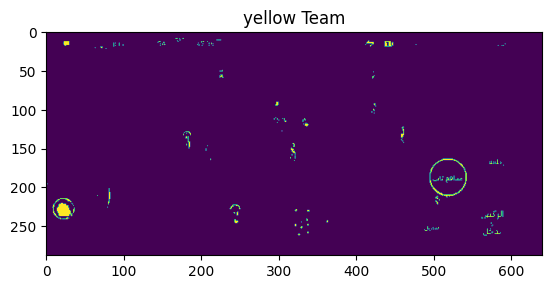

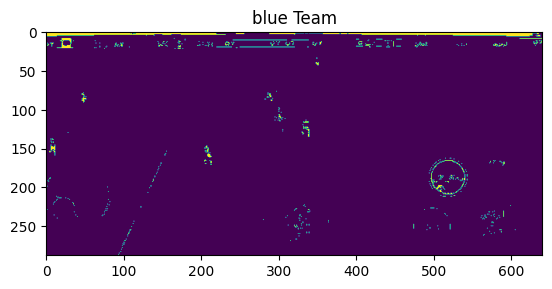

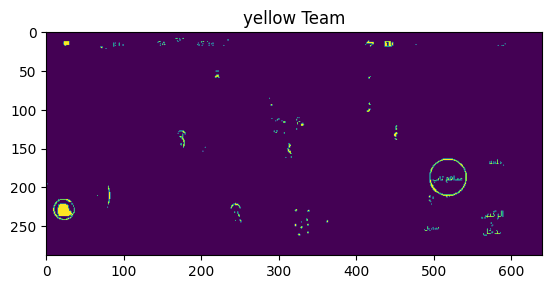

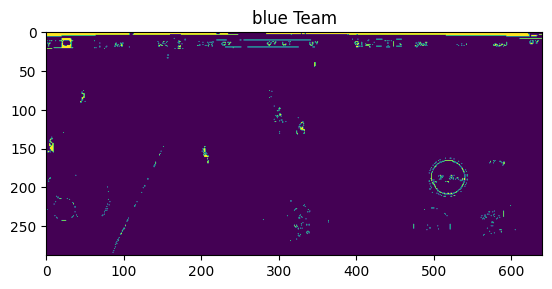

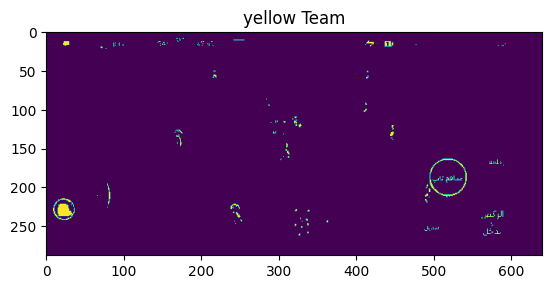

...

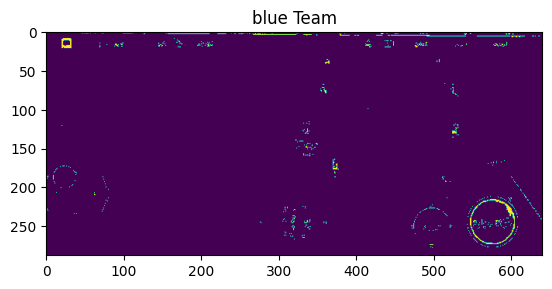

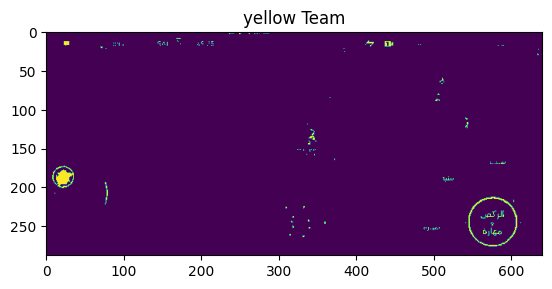

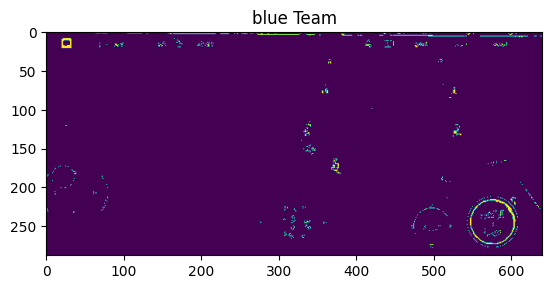

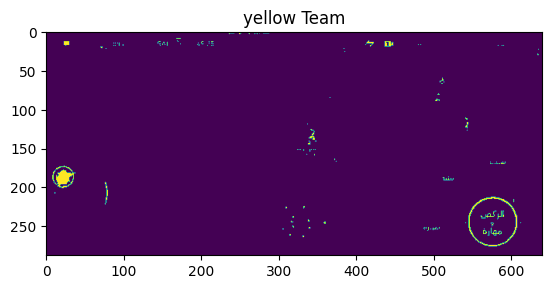

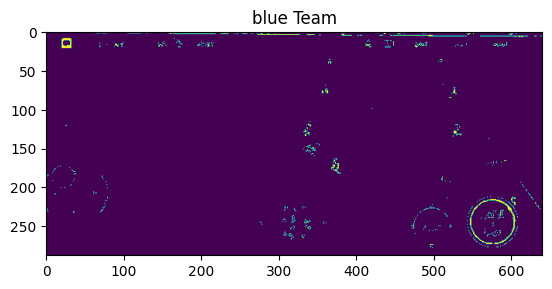

In [ ]:
#step 4

frame_ranges = [(0, 5), (20, 25), (50, 55), (70, 75), (90, 95)]

cap = cv2.VideoCapture('DataExample.mp4')
counter = 0
frametotal = []

for start_frame, end_frame in frame_ranges:
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    if start_frame >= total_frames or end_frame >= total_frames:
        print(f"Invalid frame range: {start_frame} to {end_frame}")
        continue

    cap.set(cv2.CAP_PROP_POS_FRAMES, start_frame)
    for frame_count in range(start_frame, end_frame + 1):
        ret, frame = cap.read()
        frametotal.append(frame)
        counter += 1
        frame_count += 1
        if frame_count > end_frame:
          break

cap.release()


loweryellow = np.array([183, 146, 108])
upperyellow = np.array([255, 255, 255])

lowerblue = np.array([64, 80, 119])
upperblue = np.array([162, 170, 180])

for i in range(len(frametotal)):
  imgT = frametotal[i]
  plt.imshow(cv2.cvtColor(imgT, cv2.COLOR_BGR2RGB))
  imgT2 = cv2.cvtColor(imgT, cv2.COLOR_BGR2RGB)
  plt.imshow(imgT2)

  maskT = cv2.inRange(imgT2, loweryellow, upperyellow)
  plt.subplot(1, 1, 1)
  plt.imshow(maskT)
  plt.title('yellow Team')
  plt.show()

  maskT = cv2.inRange(imgT2, lowerblue, upperblue)
  plt.subplot(1, 1, 1)
  plt.imshow(maskT)
  plt.title('blue Team')
  plt.show()

In [ ]:
#step 5
def Ball(frame):

    hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    ball_range = (np.array([0, 0, 200]),
                  np.array([180, 50, 255]) )

    ball_pixels = []
    for y in range(frame.shape[0]):
        for x in range(frame.shape[1]):
            pixel_color = hsv_frame[y, x]

            if ball_range[0][0] <= pixel_color[0] <= ball_range[1][0] and ball_range[0][1] <= pixel_color[1] <= ball_range[1][1] and ball_range[0][2] <= pixel_color[2] <= ball_range[1][2]:
                ball_pixels.append((x, y))

    sum_x = 0
    sum_y = 0
    ball_x = 0
    ball_y = 0

    if len(ball_pixels) > 0:
        for i in range(len(ball_pixels)):
            sum_x += ball_pixels[i][0]
            sum_y += ball_pixels[i][1]
        ball_x = sum_x / len(ball_pixels)
        ball_y = sum_y / len(ball_pixels)

        frame_width = frame.shape[1]

        if ball_x < frame_width / 5:
           ball_location = "Ultra Offensive Zone"
        elif ball_x < (2 * frame_width) / 5:
            ball_location = "Offensive Zone"
        elif ball_x < (3 * frame_width) / 5:
            ball_location = "Central Zone"
        elif ball_x < (4 * frame_width) / 5:
            ball_location = "Defensive Zone"
        else:
            ball_location = "Ultra Defensive Zone"

        width = frame.shape[1]
        height = frame.shape[0]

        mask = np.zeros((height, width), dtype=np.uint8)

        for pixel in ball_pixels:
            x, y = pixel
            mask[y, x] = 255

        ball_image = np.zeros(frame.shape, np.uint8)
        for i in range(frame.shape[0]):
            for j in range(frame.shape[1]):
                if mask[i, j] != 0:
                    ball_image[i, j] = frame[i, j]
    else:
        ball_location = "Unknown"
        ball_image = frame

    return ball_image, ball_location

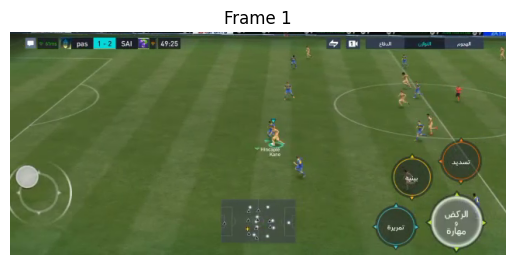

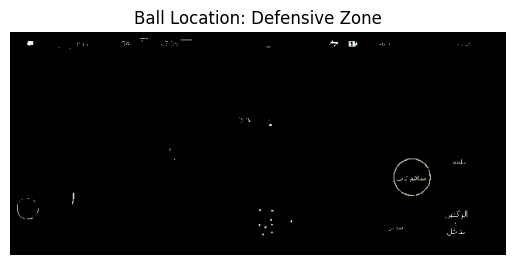

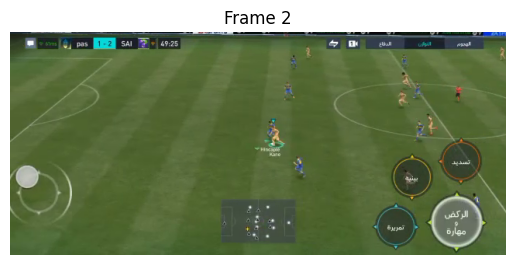

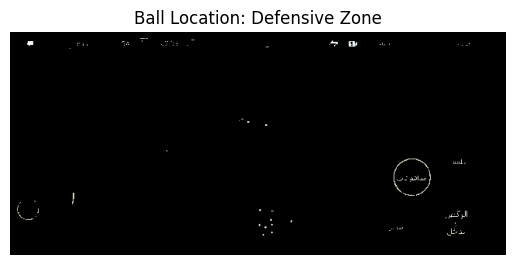

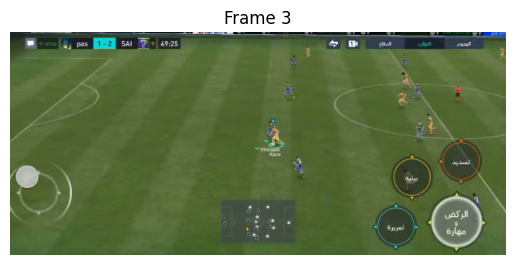

...

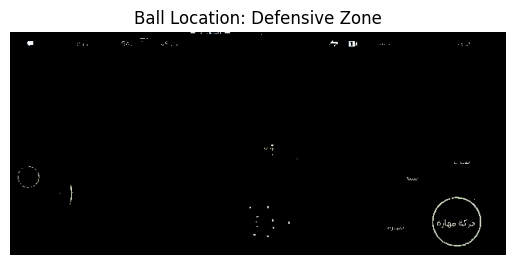

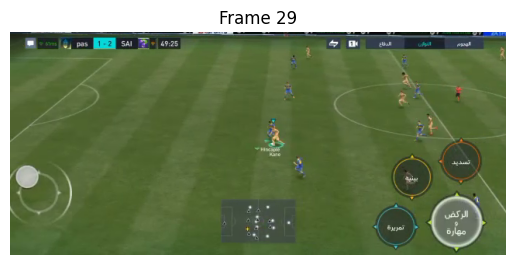

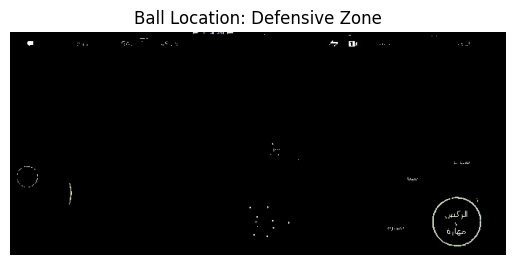

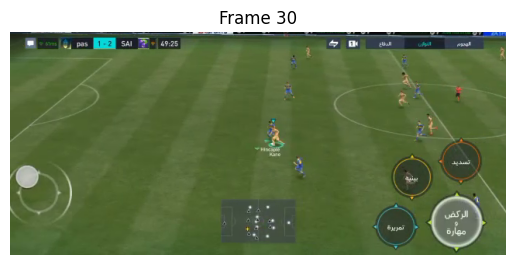

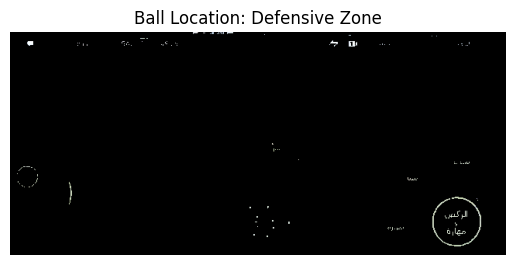

In [ ]:
# step 5
for i in range(len(frametotal)):
    ball_image, ball_location = Ball(frametotal[i])
    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(f'Frame {i+1}')
    plt.show()

    plt.imshow(cv2.cvtColor(ball_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(f'Ball Location: {ball_location}')
    plt.show()

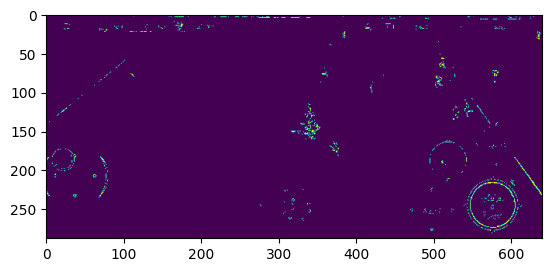

In [ ]:
# step 3
hsv_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
img_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

lower = np.array([0,10,150])
upper = np.array([255,240,180])

region = cv2.inRange(hsv_frame,lower,upper)
plt.imshow(region)
plt.show()